Я загружаю по одной фотографии из набора (галереи пользователя). Для каждого фото я определяю, есть ли люди. Если есть и их больше двух countGoodForGroup++, если есть и они младше 16 лет, countGoodForKids++

Если людей на фото нет, то присваиваем лейбл для фото: инсайд, аутсайд, фуд, дринк.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from PIL import Image
import glob
import numpy as np

In [ ]:
import cv2
#from mtcnn import MTCNN
import matplotlib.pyplot as plt

## People recognition preparing

 сеть hse_faceRec

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
import os

plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

In [ ]:
os.chdir('/content/drive/MyDrive/для диплома/HSE_FaceRec_tf-master/age_gender_identity')
from facial_analysis import FacialImageProcessing
imgProcessing=FacialImageProcessing(True)

MTCNN detector loaded
Tensor("age_pred/Softmax:0", shape=(None, 100), dtype=float32) Tensor("gender_pred/Sigmoid:0", shape=(None, 1), dtype=float32) Tensor("global_pooling/Mean:0", shape=(None, 1024), dtype=float32)
Tensor("input_1:0", shape=(None, 224, 224, 3), dtype=float32) 224 224


In [ ]:
#for testing
image = cv2.cvtColor(cv2.imread('/content/drive/MyDrive/для диплома/testgallery/IMG_20191010_145641.jpg'), cv2.COLOR_BGR2RGB)

detection elapsed 4.9138524532318115
gender [0.10477266]
age 24.471128582954407
[23 24] [0.05806614 0.05172626] [0.52887213 0.4711279 ]
age gender elapsed 0.05337858200073242
1 [24.471128582954407]


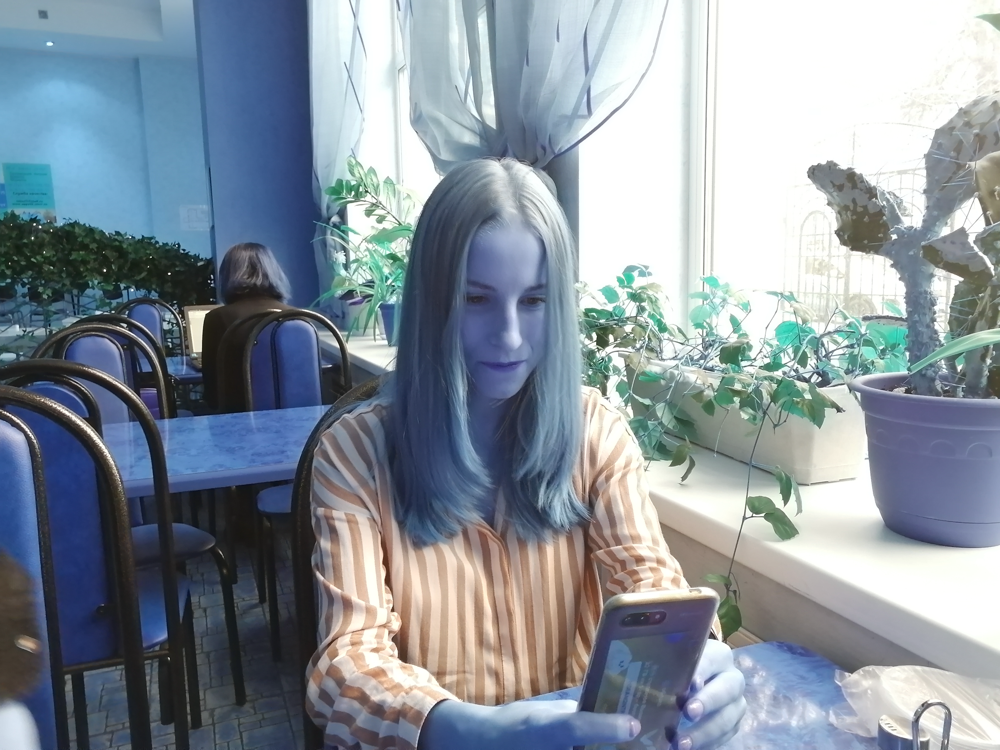

In [ ]:
from google.colab.patches import cv2_imshow
bboxes, points, ages, genders, facial_features=imgProcessing.process_image(image)
print(len(bboxes), ages)
cv2_imshow(image)

In [ ]:
areThereKids = [age<16 for age in ages]
any(areThereKids)

True

## Label prediction preparing

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [ ]:
# Get feature vector of an image by given model and img_path
def getFeatureVector(model, img_path):
  img = cv2.imread(img_path)
  img = cv2.resize(img, (224, 224))
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  feature_vector = model.predict(img.reshape(1, 224, 224, 3))
  return feature_vector

In [ ]:
#download model for labels prediction


## All algorithm

Загружаем все фотографии пользователя, проходимся по каждой фотографии и определяем количество фотографий с группами или детьми.

In [ ]:
from google.colab.patches import cv2_imshow
countGroup = 0
countKids = 0
countPhotos = 0
labels=[]
imagesforclass = []
for filename in glob.iglob('/content/drive/MyDrive/для диплома/testgallery//*.jpg'): #assuming jpg
    print('Finding people')
    countPhotos+=1
    image = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
    bboxes, points, ages, genders, facial_features=imgProcessing.process_image(image)
    numPeople = len(bboxes)
    print(numPeople)
    print(ages)
    areThereKids = [age<16 for age in ages]
    if numPeople == 0:
        imagesforclass.append(image)
        print('Labeling photos')
        feature_vector = getFeatureVector(vgg_conv, filename)
        preds = model.predict(np.reshape(feature_vector, (1, 7 * 7 * 512)))
        pred_class = np.argmax(preds)
        pred_label = idx2label[pred_class]
        print('predicted label is ', pred_label)
    countKids += int(any(areThereKids))
    if numPeople > 2:
        countGroup+=1
    

print(countGroup, countKids, countPhotos, len(imagesforclass))        

После анализа всех фотографий, присваиваем лейблы человеку

In [ ]:
#after I process all photos
if countGroup > 0.3*countPhotos:
    labels.append('GoodForGroups')
if countKids > 0.3*countPhotos:
    labels.append('GoodForKids')

In [ ]:
print(labels)

[]


## Restaurant recommendation

Загружаем датасет бизнесов, для каждого ресторана вытаскиваем нужные метки, выстраиваем по рейтингу (если есть рейтинг) и сопоставляем с пользователем

In [ ]:
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
#функция для чтения json


def load_rows(filepath, nrows = None):
    with open(filepath, encoding='utf-8') as json_file:
        count = 0
        objs = []
        line = json_file.readline()
        while (nrows is None or count < nrows) and line:
            count += 1
            obj = json.loads(line)
            objs.append(obj)
            line = json_file.readline()
        return pd.DataFrame(objs)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#download json as dataframe
business = load_rows('/content/drive/MyDrive/для диплома/yelp_academic_dataset_business.json')
business.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","Active Life, Gun/Rifle Ranges, Guns & Ammo, Sh...","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'..."
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","Health & Medical, Fitness & Instruction, Yoga,...",None
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"Pets, Pet Services, Pet Groomers",None
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Hardware Stores, Home Services, Building Suppl...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ..."
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Plumbing, Electricians, Handyma...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '..."


###Cuisine labels

In [ ]:
#food classification
tecres = {'Latin': ['Mexican', 'Latin American','Spanish' 'Portuguese'],
              'Seafood': ['Mediterranean', 'Greek', 'Caribbean', 'Seafood'], 
              'American': ['American', 'Southern', 'Canadian'],
              'Asian': ['Japanese', 'Asian', 'Chinese', 'Korean', 'Thai', 'Taiwanes', 'Sushi Bars', 'Noodles'],
              'Italian': ['Italian', 'Pizza'],
              'European': ['French', 'Irish', 'British'],
              'EasternEurope': ['Russian', 'Polish'],
              'Indian': ['Indian'],
              'Desserts': ['Ice cream', 'Desserts', 'Bakeries', 'Tea', 'Donuts'],
              'Healthy food': ['Smoothies', 'Salad', 'Vegetarian'],
              'West Asia': ['Armenian', 'Iranian', 'Turkish']}
df2 = business.reset_index(drop=True)
values=[]
#df2['Cuisine']= 0
for colname in tecres.keys():
    df2[colname]=0
    print('working on '+colname)
    for row in df2.itertuples():
        for item in tecres[colname]:
            if (row.categories == None):
                continue
            elif (item in row.categories):
                df2[colname][row.Index] = 1
    values.append(df2[colname].value_counts())

working on Latin


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


working on Seafood
working on American
working on Asian
working on Italian
working on European
working on EasternEurope
working on Indian
working on Desserts
working on Healthy food
working on West Asia


In [ ]:
df2

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","Active Life, Gun/Rifle Ranges, Guns & Ammo, Sh...","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",0,0,0,0,0,0,0,0,0,0,0,0
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","Health & Medical, Fitness & Instruction, Yoga,...",None,0,0,0,0,0,0,0,0,0,0,0,0
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"Pets, Pet Services, Pet Groomers",None,0,0,0,0,0,0,0,0,0,0,0,0
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Hardware Stores, Home Services, Building Suppl...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ...",0,0,0,0,0,0,0,0,0,0,0,0
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Plumbing, Electricians, Handyma...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '...",0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209388,9Q0fPWAjUweoFDk0kafuzQ,Nishi Sushi,9750 Weston Road,Vaughan,ON,L4H 2P2,43.838555,-79.559823,4.0,5,0,"{'Ambience': '{'romantic': False, 'intimate': ...","Japanese, Sushi Bars, Restaurants","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",0,0,0,0,1,0,0,0,0,0,0,0
209389,PotiAhtDMYMNsJCzV0oLAw,Walmart,3240 Wilkinson Blvd,Charlotte,NC,28208,35.226307,-80.893539,2.0,13,0,"{'RestaurantsPriceRange2': '1', 'BusinessParki...","Department Stores, Food, Mobile Phones, Fashio...",None,0,0,0,0,0,0,0,0,0,0,0,0
209390,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","American (New), Food, Burgers, Restaurants, Fa...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",0,0,0,1,0,0,0,0,0,0,0,0
209391,RSSIsgO00OuWQTRoITacpA,Indian Trail Dog Training,,Indian Trail,NC,28079,35.101965,-80.599385,5.0,3,1,None,"Pet Services, Pet Training, Pets","{'Monday': '0:0-0:0', 'Tuesday': '7:0-19:0', '...",0,0,0,0,0,0,0,0,0,0,0,0


### Good for kids label

In [ ]:
df2['GoodForKids']=0
for row in df2.itertuples():
  if row.attributes != None:
    d = dict(row.attributes)
    try:
        if d['GoodForKids']=='True':
          df2['GoodForKids'][row.Index] = 1
    except KeyError:
      continue
  else:
    continue

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
df2.describe()

,latitude,longitude,stars,review_count,is_open,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia,GoodForKids
count,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.0,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000
mean,38.579934,-97.390217,3.538055,36.937505,0.806632,0.0,0.026844,0.029098,0.064515,0.054200,0.046931,0.007140,0.000688,0.007889,0.072271,0.027288,0.001777,0.265181
std,4.940448,16.718535,1.023543,123.343597,0.394940,0.0,0.161628,0.168083,0.245669,0.226412,0.211491,0.084195,0.026215,0.088472,0.258936,0.162923,0.042112,0.441430
min,21.497258,-158.025525,1.000000,3.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33.638658,-112.269476,3.000000,4.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,36.147408,-111.743531,3.500000,9.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,43.611693,-79.972679,4.500000,27.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,51.299943,-72.806550,5.000000,10129.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### Good for groups label

In [ ]:
df2['GoodForGroups']=0
for row in df2.itertuples():
  if row.attributes != None:
    d = dict(row.attributes)
    try:
        if d['RestaurantsGoodForGroups']=='True':
          df2['GoodForGroups'][row.Index] = 1
    except KeyError:
      continue
  else:
    continue

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
print(df2['attributes'][100])

{'RestaurantsTakeOut': 'True', 'RestaurantsGoodForGroups': 'True', 'GoodForKids': 'True', 'RestaurantsDelivery': 'False', 'Alcohol': "u'none'", 'RestaurantsAttire': "u'casual'", 'RestaurantsPriceRange2': '1', 'OutdoorSeating': 'False', 'BusinessAcceptsCreditCards': 'True', 'Ambience': "{'romantic': False, 'intimate': False, 'touristy': False, 'hipster': False, 'divey': False, 'classy': False, 'trendy': False, 'upscale': False, 'casual': False}", 'RestaurantsReservations': 'False', 'NoiseLevel': "u'average'", 'BusinessParking': "{'garage': False, 'street': False, 'validated': False, 'lot': False, 'valet': False}"}


In [ ]:
df2['GoodForGroups'].value_counts()

0    160781
1     48612
Name: GoodForGroups, dtype: int64

### Has alcohol

In [ ]:
df2['HasAlcohol']=0
for row in df2.itertuples():
    if row.attributes != None:
        d = dict(row.attributes)
        try:
            if d['Alcohol']!=None:
                df2['HasAlcohol'][row.Index] = 1
        except KeyError:
            continue
    else:
        continue

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
df2['HasAlcohol'].value_counts()

0    158555
1     50838
Name: HasAlcohol, dtype: int64

### Outdoor seating

In [ ]:
df2['OutdoorSeating']=0
for row in df2.itertuples():
  if row.attributes != None:
    d = dict(row.attributes)
    try:
        if d['OutdoorSeating']=='True':
          df2['OutdoorSeating'][row.Index] = 1
    except KeyError:
      continue
  else:
    continue

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
df2['OutdoorSeating'].value_counts()

0    184449
1     24944
Name: OutdoorSeating, dtype: int64

### Ambience

In [ ]:
ambiences = ['touristy', 'hipster', 'romantic', 'intimate', 'trendy', 'upscale', 'classy', 'casual']

In [ ]:
import ast
for colname in ambiences:
    df2[colname]=0
    print('working on '+colname)
    for row in df2.itertuples():
          if row.attributes != None:
                  d = dict(row.attributes)
                  try:
                    #print(ast.literal_eval(d['Ambience']))
                    if ast.literal_eval(d['Ambience'])!= None:
                        try:
                          if ast.literal_eval(d['Ambience'])[colname] == None:
                            df2[colname][row.Index] = 0
                          else:  
                            df2[colname][row.Index] = int(ast.literal_eval(d['Ambience'])[colname])
                        except KeyError:
                            continue
                  except KeyError:
                        continue 

working on touristy


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]


working on hipster
working on romantic
working on intimate
working on trendy
working on upscale
working on classy
working on casual


In [ ]:
df2.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia,GoodForKids,GoodForGroups,HasAlcohol,OutdoorSeating,touristy,hipster,romantic,intimate,trendy,upscale,classy,casual
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","Active Life, Gun/Rifle Ranges, Guns & Ammo, Sh...","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","Health & Medical, Fitness & Instruction, Yoga,...",None,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"Pets, Pet Services, Pet Groomers",None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Hardware Stores, Home Services, Building Suppl...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Plumbing, Electricians, Handyma...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df2.describe()

,latitude,longitude,stars,review_count,is_open,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia,GoodForKids,GoodForGroups,HasAlcohol,OutdoorSeating,touristy,hipster,romantic,intimate,trendy,upscale,classy,casual
count,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.0,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000,209393.000000
mean,38.579934,-97.390217,3.538055,36.937505,0.806632,0.0,0.026844,0.029098,0.064515,0.054200,0.046931,0.007140,0.000688,0.007889,0.072271,0.027288,0.001777,0.265181,0.232157,0.242787,0.119125,0.001409,0.005521,0.002985,0.003567,0.013023,0.002651,0.032117,0.105653
std,4.940448,16.718535,1.023543,123.343597,0.394940,0.0,0.161628,0.168083,0.245669,0.226412,0.211491,0.084195,0.026215,0.088472,0.258936,0.162923,0.042112,0.441430,0.422209,0.428769,0.323937,0.037508,0.074096,0.054552,0.059622,0.113375,0.051415,0.176310,0.307394
min,21.497258,-158.025525,1.000000,3.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33.638658,-112.269476,3.000000,4.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,36.147408,-111.743531,3.500000,9.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,43.611693,-79.972679,4.500000,27.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,51.299943,-72.806550,5.000000,10129.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
df2.to_pickle("business_attributes.pkl")

In [ ]:
df2 = pd.read_pickle("/content/drive/MyDrive/для диплома/business_attributes.pkl")

In [ ]:
df2

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia,GoodForKids,GoodForGroups,HasAlcohol,OutdoorSeating,touristy,hipster,romantic,intimate,trendy,upscale,classy,casual
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","Active Life, Gun/Rifle Ranges, Guns & Ammo, Sh...","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","Health & Medical, Fitness & Instruction, Yoga,...",None,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"Pets, Pet Services, Pet Groomers",None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Hardware Stores, Home Services, Building Suppl...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Plumbing, Electricians, Handyma...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209388,9Q0fPWAjUweoFDk0kafuzQ,Nishi Sushi,9750 Weston Road,Vaughan,ON,L4H 2P2,43.838555,-79.559823,4.0,5,0,"{'Ambience': '{'romantic': False, 'intimate': ...","Japanese, Sushi Bars, Restaurants","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",0,0,0,0,1,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0
209389,PotiAhtDMYMNsJCzV0oLAw,Walmart,3240 Wilkinson Blvd,Charlotte,NC,28208,35.226307,-80.893539,2.0,13,0,"{'RestaurantsPriceRange2': '1', 'BusinessParki...","Department Stores, Food, Mobile Phones, Fashio...",None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
209390,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","American (New), Food, Burgers, Restaurants, Fa...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",0,0,0,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,0,0,1
209391,RSSIsgO00OuWQTRoITacpA,Indian Trail Dog Training,,Indian Trail,NC,28079,35.101965,-80.599385,5.0,3,1,None,"Pet Services, Pet Training, Pets","{'Monday': '0:0-0:0', 'Tuesday': '7:0-19:0', '...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
#download photos.json as dataframe
photos = load_rows('/content/drive/MyDrive/для диплома/photos.json')
photos.describe()

,photo_id,business_id,caption,label
count,200000,200000,200000,200000
unique,200000,39830,72475,5
top,MX4A-kk1OSLXwHJwtI5QCw,RESDUcs7fIiihp38-d6_6g,,food
freq,1,652,107420,118597


In [ ]:
#Убираем лишний столбцы, соединяем в один dataframe
df = pd.merge(df2, photos, how ='inner', on ='business_id')
#df = df.drop (columns = ['address', 'city', 'state', 'postal_code', 'latitude', 'longitude', 'stars', 'review_count', 'is_open', 'hours'])
df

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,Cuisine,Latin,Seafood,American,Asian,Italian,European,EasternEurope,Indian,Desserts,Healthy food,West Asia,GoodForKids,GoodForGroups,HasAlcohol,OutdoorSeating,touristy,hipster,romantic,intimate,trendy,upscale,classy,casual,photo_id,caption,label
0,eBEfgOPG7pvFhb2wcG9I7w,Philthy Phillys,"15480 Bayview Avenue, unit D0110",Aurora,ON,L4G 7J1,44.010962,-79.448677,4.5,4,1,"{'RestaurantsTableService': 'False', 'Restaura...","Restaurants, Cheesesteaks, Poutineries","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,wqDC9EuJ9dH8TXrzQ3xXlw,,inside
1,98hyK2QEUeI8v2y0AghfZA,Pho Lee's Vietnamese Restaurant,"1541 E 38th St, Ste 101",Cleveland,OH,44114,41.512155,-81.663332,4.5,23,1,"{'BusinessParking': 'None', 'Ambience': '{'tou...","Restaurants, Vietnamese, Soup","{'Monday': '11:0-20:0', 'Wednesday': '11:0-20:...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,LwfxIxgUum7IJGIC2quzNw,Bun (vermicelli rice noodles) with vegetarian ...,food
2,xFc50drSPxXkcLvX5ygqrg,Boomer's Sweet Home Chicago,"5932 W Bell Rd, Ste D-109",Glendale,AZ,85308,33.640391,-112.187028,3.5,12,0,"{'BusinessAcceptsCreditCards': 'True', 'Busine...","Burgers, Fast Food, American (New), Restaurant...",None,0,0,0,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,It8s_DFhLp8rr10ZX3aRfg,59th Ave and Bell Road,outside
3,tLpkSwdtqqoXwU0JAGnApw,Wendy's,4602 Northfield Road,Cleveland,OH,44128,41.434614,-81.527026,3.5,7,1,"{'RestaurantsDelivery': 'False', 'BusinessAcce...","Restaurants, Fast Food, Burgers","{'Monday': '10:0-3:0', 'Tuesday': '10:0-3:0', ...",0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,_DHPol26aeM6vp4pRAWigQ,,food
4,3BfGGIJn8lxvu1k3ZZnL1w,Théâtre Corona,2490 Rue Notre-Dame O,Montréal,QC,H3J 1N5,45.482777,-73.575006,4.0,18,1,"{'OutdoorSeating': 'False', 'RestaurantsPriceR...","Nightlife, Arts & Entertainment, Performing Ar...",None,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,EL9EVBXXx5AyrMZNQqyC-A,,outside
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,hskVqZCPqy-omm9CHi44xQ,Domino's,"6420 Rea Rd, Suite B1",Charlotte,NC,28226,35.078538,-80.818358,2.0,16,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Restaurants, Pizza, Sandwiches, Fast Food, Chi...","{'Monday': '10:30-0:0', 'Tuesday': '10:30-0:0'...",0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,FGWrGMzNz_EXMEimDuNQbw,,food
199996,hskVqZCPqy-omm9CHi44xQ,Domino's,"6420 Rea Rd, Suite B1",Charlotte,NC,28226,35.078538,-80.818358,2.0,16,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Restaurants, Pizza, Sandwiches, Fast Food, Chi...","{'Monday': '10:30-0:0', 'Tuesday': '10:30-0:0'...",0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,k_MYnl0T07mSrBHVMtwzgw,,food
199997,hskVqZCPqy-omm9CHi44xQ,Domino's,"6420 Rea Rd, Suite B1",Charlotte,NC,28226,35.078538,-80.818358,2.0,16,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Restaurants, Pizza, Sandwiches, Fast Food, Chi...","{'Monday': '10:30-0:0', 'Tuesday': '10:30-0:0'...",0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,Kow-BJQYdBCXAtxr7hCmoA,,food
199998,hskVqZCPqy-omm9CHi44xQ,Domino's,"6420 Rea Rd, Suite B1",Charlotte,NC,28226,35.078538,-80.818358,2.0,16,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","Restaurants, Pizza, Sandwiches, Fast Food, Chi...","{'Monday': '10:30-0:0', 'Tuesday': '10:30-0:0'...",0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,NamHXDBkWsaqO74u8ZxhEQ,,food


In [ ]:
my_labels = {'people': ['GoodForKids'], 'cuisine': ['Healthy food', 'European'], 'ambience': ['classy', 'casual'] }

In [ ]:
restaurant_ids = []
for key in my_labels.keys():
  columns = my_labels[key],
  for col in columns:
    for row in df.itertuples():
      if row.GoodForGroups == 1 and (row.Desserts==1 or row.EasternEurope==1) and row.OutdoorSeating == 1 and (row.trendy == 1 or row.casual == 1):
        restaurant_ids.append(row.business_id)
unique(restaurant_ids)

In [ ]:
len(set(restaurant_ids))

858

In [ ]:
mask=[]
for id in df['business_id']:
  if id in set(restaurant_ids):
    mask.append(True)
  else:
    mask.append(False)

small_photos=df[mask]
small_photos

In [ ]:
import os
files = os.listdir('/content/drive/MyDrive/для диплома/photos')
image_ids=[]
for imagename in files:
  image_ids.append(imagename.replace(".jpg", ""))

mask=[]
for id in small_photos['photo_id']:
  if id in image_ids:
    mask.append(True)
  else:
    mask.append(False)

small_photos=small_photos[mask]
small_photos

In [ ]:
small_photos[small_photos['city'] == 'Las Vegas'].sort_values('stars', ascending = False)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
train_dir = '/content/drive/MyDrive/для диплома/photos'
#kids = np.where(df['GoodForKids'] == 1)[0]
for row in small_photos[small_photos['city'] == 'Las Vegas'].sort_values('stars', ascending = False).itertuples():
    print('Reasturant name is %s' % row.name)
    original = load_img('{}/{}.jpg'.format(train_dir,row.photo_id))
    plt.axis('off')
    plt.imshow(original)
    plt.show()

Reasturant name is 308    Loftti Cafe
Name: name, dtype: object


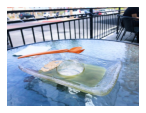

Reasturant name is 82790    Rosallie
Name: name, dtype: object


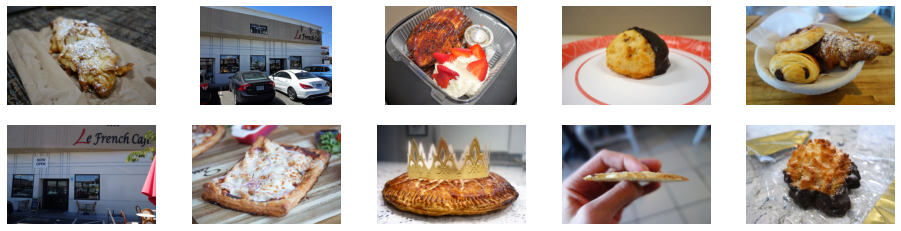

Reasturant name is 10355    Jamboree Bagel Restaurant & Cafe
Name: name, dtype: object


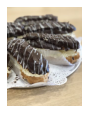

Reasturant name is 73437    Eatt Gourmet Bistro
Name: name, dtype: object


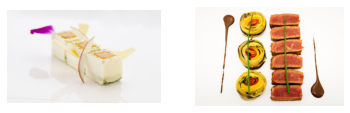

Reasturant name is 74374    Veganbites
Name: name, dtype: object


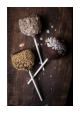

Reasturant name is 94385    The Cuppa
Name: name, dtype: object


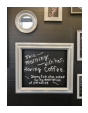

Reasturant name is 109247    The Goodwich Downtown
Name: name, dtype: object


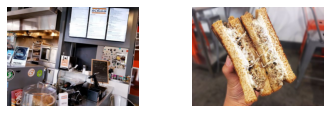

Reasturant name is 201201    Bronze Cafe at The Market
Name: name, dtype: object


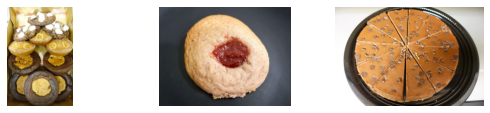

Reasturant name is 193741    Panacea
Name: name, dtype: object


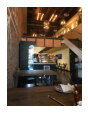

Reasturant name is 190931    Pour Coffeehouse
Name: name, dtype: object


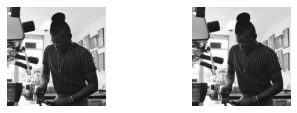

Reasturant name is 183295    Veganbites
Name: name, dtype: object


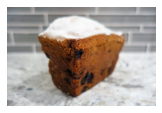

Reasturant name is 172685    Le Petit Café & Bakery
Name: name, dtype: object


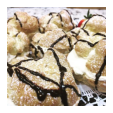

Reasturant name is 169812    CJ's Italian Ice & Custard
Name: name, dtype: object


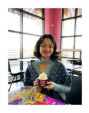

Reasturant name is 154885    Toast Society Cafe
Name: name, dtype: object


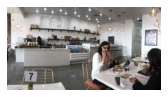

Reasturant name is 145437    Roma Coffee
Name: name, dtype: object


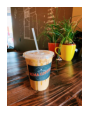

Reasturant name is 142029    Carson Kitchen
Name: name, dtype: object


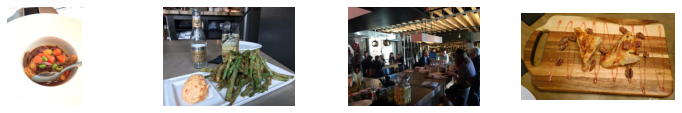

Reasturant name is 130551    Donut Bar
Name: name, dtype: object


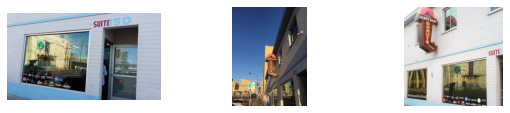

Reasturant name is 124714    Strip View Cafe
Name: name, dtype: object


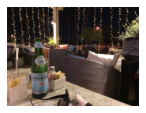

Reasturant name is 119812    Grouchy John's Coffee
Name: name, dtype: object


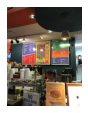

Reasturant name is 111160    Cafe Breizh
Name: name, dtype: object


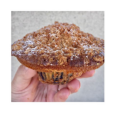

Reasturant name is 46532    Cafe Mayakovsky
Name: name, dtype: object


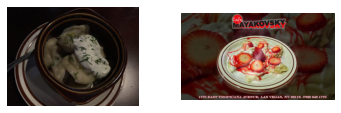

Reasturant name is 20887    Leoné Café
Name: name, dtype: object


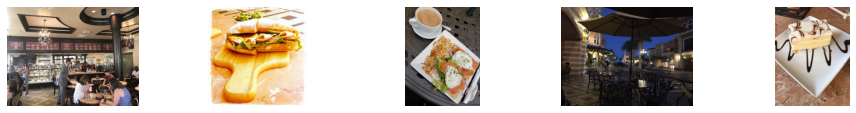

Reasturant name is 26822    PublicUs
Name: name, dtype: object


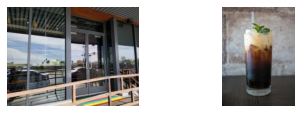

Reasturant name is 62415    Pizza house & bakery Middle East Fast Food
Name: name, dtype: object


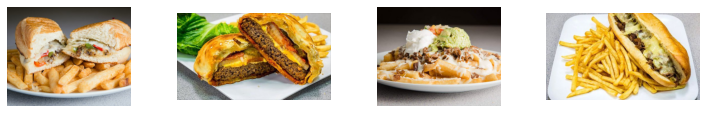

Reasturant name is 22692    Sunrise Coffee
Name: name, dtype: object


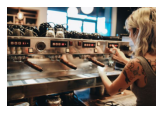

Reasturant name is 20725    Baguette Cafe
Name: name, dtype: object


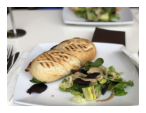

Reasturant name is 14955    Bonjour Bakery & Deli
Name: name, dtype: object


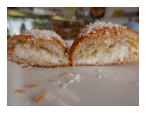

Reasturant name is 70849    Tacos Huevos
Name: name, dtype: object


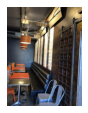

Reasturant name is 183352    La Belle Terre Bakery & Café
Name: name, dtype: object


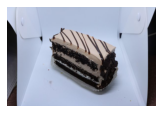

Reasturant name is 205151    Lulu's Bread & Breakfast
Name: name, dtype: object


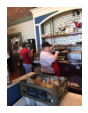

Reasturant name is 208177    Bad Owl Coffee Roasters
Name: name, dtype: object


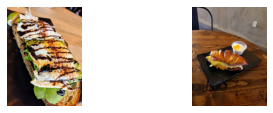

Reasturant name is 135430    Sambalatte
Name: name, dtype: object


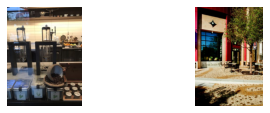

Reasturant name is 138031    Dog Haus Biergarten
Name: name, dtype: object


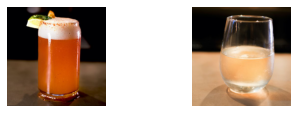

Reasturant name is 35275    Globe Cafe
Name: name, dtype: object


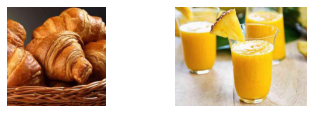

Reasturant name is 32917    Pawn Donut and Coffee
Name: name, dtype: object


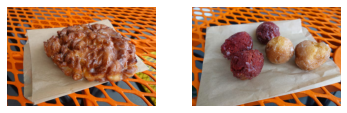

Reasturant name is 162672    Flippin' Good Chicken, Burgers, Beer
Name: name, dtype: object


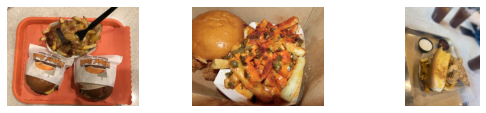

Reasturant name is 159534    Sambalatte
Name: name, dtype: object


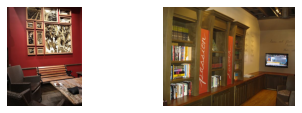

Reasturant name is 19645    Cheffini's Hot Dogs
Name: name, dtype: object


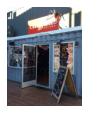

Reasturant name is 127774    Grand Lux Cafe
Name: name, dtype: object


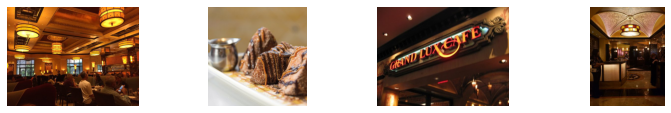

Reasturant name is 197050    Bouchon Bakery
Name: name, dtype: object


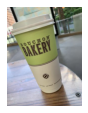

Reasturant name is 179916    Dirty Fork
Name: name, dtype: object


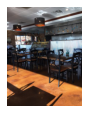

Reasturant name is 181513    Manan Bakery
Name: name, dtype: object


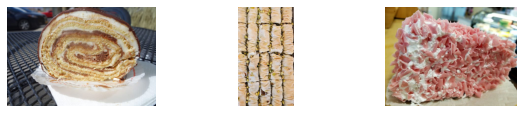

Reasturant name is 49024    Rolling in Dough Bakery & Cafe
Name: name, dtype: object


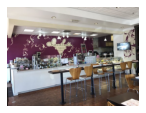

Reasturant name is 65853    Green Dacha Grill & Hookah
Name: name, dtype: object


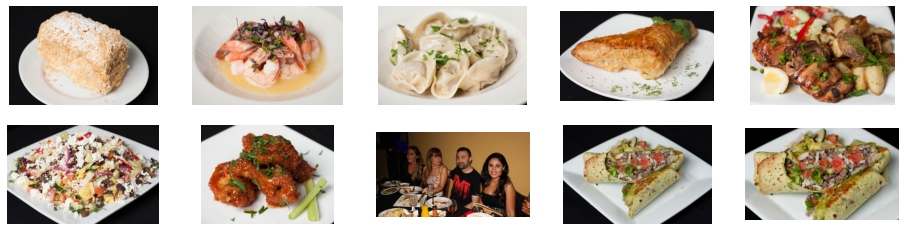

Reasturant name is 65421    Makers & Finders
Name: name, dtype: object


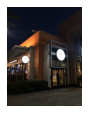

Reasturant name is 60623    HEXX kitchen + bar
Name: name, dtype: object


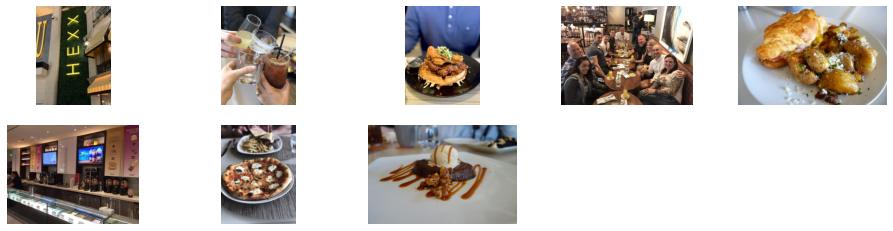

Reasturant name is 66369    Pineapple Park
Name: name, dtype: object


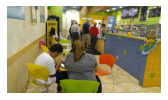

Reasturant name is 124740    Cinnaholic
Name: name, dtype: object


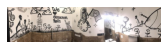

Reasturant name is 53851    Andre's Bistro & Bar
Name: name, dtype: object


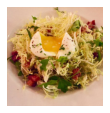

Reasturant name is 93312    Cafe Lola
Name: name, dtype: object


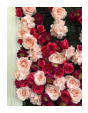

Reasturant name is 187848    The Market
Name: name, dtype: object


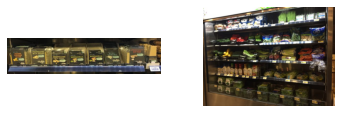

Reasturant name is 119813    The Cheesecake Factory
Name: name, dtype: object


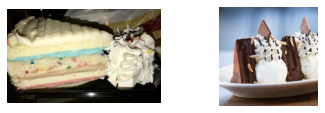

Reasturant name is 135451    Waffle Bar
Name: name, dtype: object


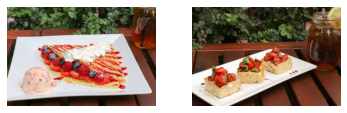

Reasturant name is 153122    The Cheesecake Factory
Name: name, dtype: object


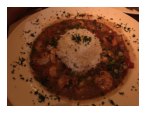

Reasturant name is 97450    Havana Express Cuban Kitchen & Bakery
Name: name, dtype: object


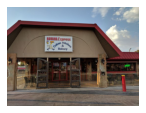

Reasturant name is 162013    McDonald's
Name: name, dtype: object


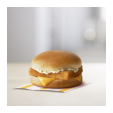

Reasturant name is 199019    Le Cafe Ile St. Louis
Name: name, dtype: object


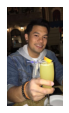

Reasturant name is 158935    Tea Station
Name: name, dtype: object


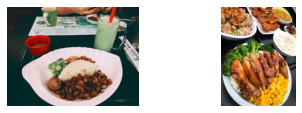

Reasturant name is 72200    McDonald's
Name: name, dtype: object


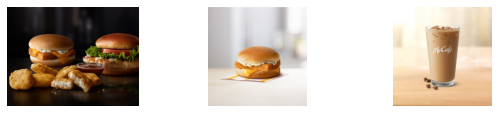

In [ ]:
for business_id in small_photos[small_photos['city'] == 'Las Vegas'].sort_values('stars', ascending = False)['business_id'].unique():
  # Создадим фигуру размером 16 на 4 дюйма
  pic_box = plt.figure(figsize=(16,4))
  photos = small_photos[small_photos['business_id'] == business_id]['photo_id']
  name = business[business['business_id'] == business_id]['name']
  print('Reasturant name is %s' % name)
  for i, picture in enumerate(photos):
        if i > 9:
          break
        original = load_img('{}/{}.jpg'.format(train_dir,picture))
        # добавляем ячейку в pix_box для вывода текущего изображения
        pic_box.add_subplot(2,5,i+1)
        plt.imshow(original)
        # отключаем отображение осей
        plt.axis('off')
  # выводим все созданные фигуры на экран
  plt.show()  
